In [296]:
import sys, wave
import numpy as np
from numpy import array, int16
from scipy.signal import lfilter, butter
from scipy.io.wavfile import read,write
from scipy import signal
from IPython.lib.display import Audio
from scipy.fftpack import fft , ifft, fftshift, ifftshift 

pi = np.pi
gsignal

def Read_Audio(filename):
    Fs, xn = read(filename)
    xn = convert_to_mono_audio(xn)
    Plot_Spectrum(xn, 10000)
    global gsignal
    gsignal = xn
    print(Fs)
    display(Audio(xn, rate=Fs))
    

def Plot_Spectrum(signal, points):        #Herhangi sinyalin arzu edilen noktada fourieri alınıp çizilmesi
    N = points
    n = np.arange(-N/2,N/2)
    w = np.arange(-pi,pi, 2*pi/N)
    xw = fftshift(fft(signal, N)/N)
    plt.figure()
    plt.stem(w/np.pi, abs(xw))
    plt.xlabel('wx$\pi$')
    plt.title('Genlik Grafiği')

def convert_to_mono_audio(input_audio):
    output_audio = []
    temp_audio = input_audio.astype(float)
    for i in temp_audio:
        output_audio.append((i[0] / 2) + (i[1] / 2))   #2 sütundaki değerlerin ortalaması alındı ve bunlar tek kanala sokuldu.
    return np.array(output_audio, dtype = 'int16')
        
def set_reverse(input_audio):
    input_audio = input_audio[::-1]  #Satır ve sütunların yeri değiştirilerek ses tersten oynatılacak
    global gsignal
    gsignal = input_audio
    display(Audio(input_audio, rate=Fs))

def set_echo(delay, audio_data):
    output_audio = np.zeros(len(audio_data))
    output_delay = delay * Fs
    for count, i, in enumerate(audio_data):
        output_audio[count] = i + audio_data[count - int(output_delay)]
    audio_data = output_audio
    global gsignal
    gsignal = audio_data
    display(Audio(audio_data, rate=Fs))

def set_speed(speed_factor, xn):
    sound_index = np.round(np.arange(0, len(xn), speed_factor))
    xn = xn[sound_index[sound_index < len(xn)].astype(int)]
    global gsignal
    gsignal = xn
    display(Audio(xn, rate=Fs))
    
def set_lowpass(cutoff_low, order = 5):   #5.dereceden dijital IIR Butterworth AGF
    print(cutoff_low*2*pi/Fs,"($\pi$ cinsinden)")
    nyquist = Fs/2
    cutoff = cutoff_low / nyquist
    x, y = butter(order,cutoff, btype='lowpass',analog = False)
    Plot_Spectrum(x,10000)
    global gsignal
    gsignal = signal.filtfilt(x,y,gsignal)
    display(Audio(gsignal, rate=Fs))

def set_highpass(cutoff_high, order = 5):  #5.dereceden dijital IIR Butterworth YGF
    print(cutoff_high*2*pi/Fs,"($\pi$ cinsinden)")
    nyquist = Fs / 2.0
    cutoff = cutoff_high / nyquist
    x, y = signal.butter(order, cutoff, btype='highpass', analog=False)
    Plot_Spectrum(x,10000)
    global gsignal
    gsignal = signal.filtfilt(x, y, gsignal)
    display(Audio(gsignal, rate=Fs))

def set_bandpass(cutoff_low, cutoff_high, order = 5):
    print("Low_Cutoff:",cutoff_low*2*pi/Fs,"($\pi$ cinsinden)","High_Cutoff:",cutoff_high*2*pi/Fs)
    cutoff = np.zeros(2)
    nyquist = Fs / 2.0
    cutoff[0] = cutoff_low / nyquist
    cutoff[1] = cutoff_high / nyquist
    x, y = signal.butter(order, cutoff, btype='bandpass', analog=False)
    Plot_Spectrum(x,10000)
    global gsignal
    gsignal = signal.filtfilt(x, y, gsignal)
    display(Audio(gsignal, rate=Fs))

def Save_output(filename):     #Dosya kaydeden fonksiyon
    write(filename, Fs, array(xn, dtype = int16))


48000


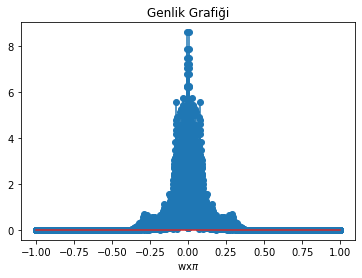

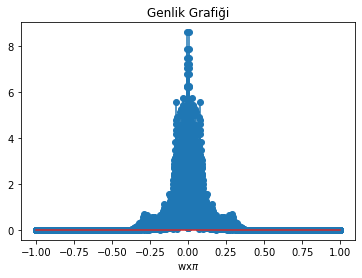

In [297]:
Read_Audio("Recording.wav") #Ses tek kanaldan okutuluyor
Plot_Spectrum(gsignal,10000) #10 bin noktada fft alıp ses çizdirildi
set_reverse(gsignal)   #Ses tersine çevrilip kaydedildi
Save_output("Breversed.wav")

48000


<ipython-input-296-75e4610388e2>:50: RuntimeWarning: overflow encountered in short_scalars
  output_audio[count] = i + audio_data[count - int(output_delay)]


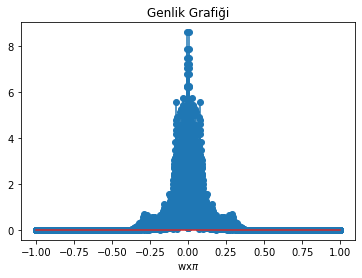

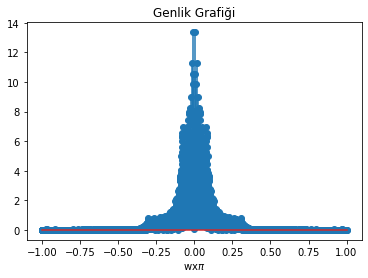

In [298]:
Read_Audio("Recording.wav")
set_echo(0.5, gsignal)
Plot_Spectrum(gsignal,10000)
Save_output("Becho.wav")

48000


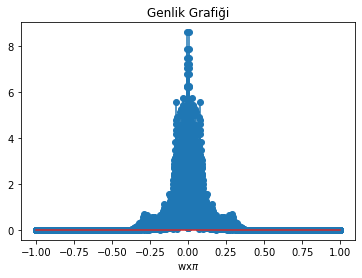

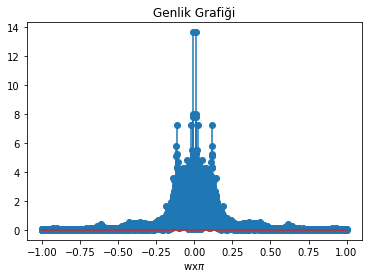

In [299]:
Read_Audio("Recording.wav")
set_speed(1.5, gsignal)
Plot_Spectrum(gsignal,10000)
Save_output("Bfast.wav")

48000


0.1308996938995747 ($\pi$ cinsinden)


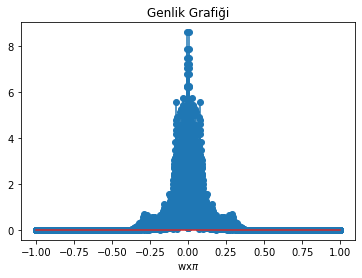

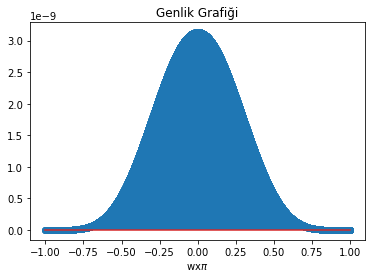

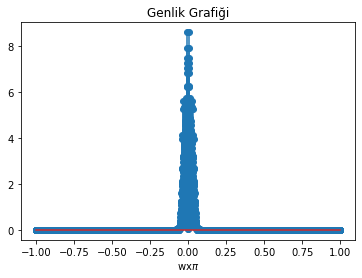

In [300]:
Read_Audio("Recording.wav")
set_lowpass(1000)
Plot_Spectrum(gsignal,10000)

48000


0.6544984694978736 ($\pi$ cinsinden)


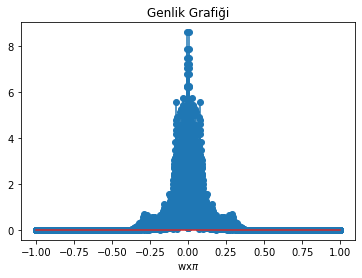

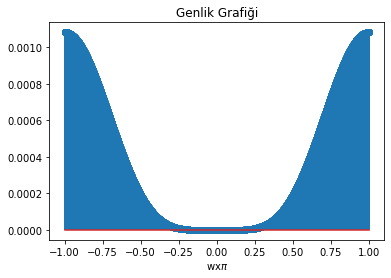

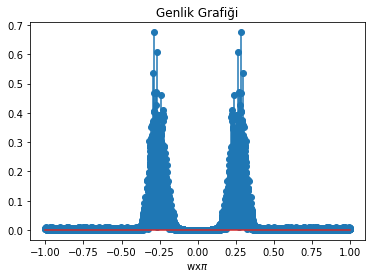

In [301]:
Read_Audio("Recording.wav")
set_highpass(5000, order = 5)
Plot_Spectrum(gsignal,10000)

48000


Low_Cutoff: 0.2617993877991494 ($\pi$ cinsinden) High_Cutoff: 0.6544984694978736


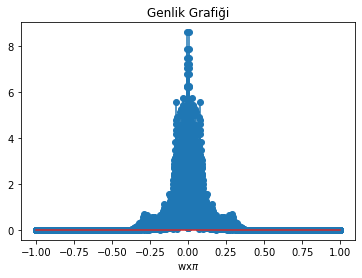

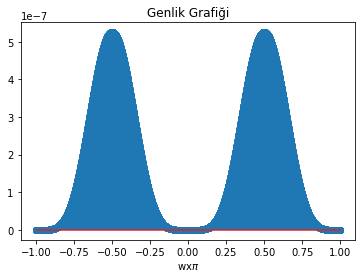

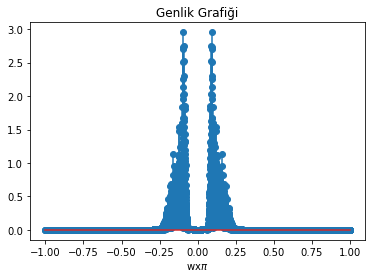

In [302]:
Read_Audio("Recording.wav")
set_bandpass(2000,5000, order = 5)
Plot_Spectrum(gsignal,10000)